## Install dependencies

In [1]:
!pip install pystac_client==0.6.1 stackstac==0.4.4

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.0/150.0 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 17.5 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 163.8/163.8 kB 16.0 MB/s eta 0:00:00
  Attempting uninstall: pystac
    Found existing installation: pystac 1.6.1
    Uninstalling pystac-1.6.1:
      Successfully uninstalled pystac-1.6.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
rastervision-core 0.20.3.dev0 requires geopandas==0.12.0, but you have geopandas 0.13.2 which is incompatible.
rastervision-core 0.20.3.dev0 requires imageio==2.22.1, but you have imageio 2.31.1 which is incompatible.
rastervision-core 0.20.3.dev0 requires numpy==1.23.3, but you have numpy 1.25.0 which is incompatible.
rastervision-core 0.20

---

In [2]:
from rastervision.core.box import Box
from rastervision.core.data import (
    MinMaxTransformer, RasterioCRSTransformer, 
    StatsTransformer, XarraySource)
from rastervision.core.data.raster_source import XarraySource

from rastervision.core.data import Scene
from rastervision.pytorch_learner import (
    SemanticSegmentationRandomWindowGeoDataset,
    SemanticSegmentationSlidingWindowGeoDataset)

import math
import numpy as np
import torch
from torchvision.transforms import Normalize

from matplotlib import pyplot as plt
import seaborn as sns
sns.reset_defaults()

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

/opt/conda/lib/python3.10/site-packages/geopandas/_compat.py:124: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


---

## Get a time-series of Sentinel-2 images from a STAC API

Get Sentinel-2 imagery from 2023-06-01 to 2023-06-20 over Paris, France.

In [4]:
import pystac_client
import stackstac

Paris

In [4]:
bbox = Box(ymin=48.8155755, xmin=2.224122, ymax=48.902156, xmax=2.4697602)
bbox_geometry = {'type': 'Polygon',
  'coordinates': (((2.224122, 48.8155755),
    (2.224122, 48.902156),
    (2.4697602, 48.902156),
    (2.4697602, 48.8155755),
    (2.224122, 48.8155755)),)}

Philadelphia

In [40]:
bbox = Box(ymin=39.84899, xmin=-75.34863, ymax=40.06426, xmax=-74.98828)
bbox_geometry = {'type': 'Polygon',
  'coordinates': (((-75.34863, 39.84899),
    (-75.34863, 40.06426),
    (-74.98828, 40.06426),
    (-74.98828, 39.84899),
    (-75.34863, 39.84899)),)}

Mariupol

In [ ]:
bbox = Box(ymin=47.213, xmin=37.490973775596366, ymax=47.0581, xmax=37.683)
bbox_geometry = {'type': 'Polygon',
  'coordinates': (((37.49547, 47.05581),
    (37.49547, 47.213),
    (37.683, 47.213),
    (37.683, 47.05581),
    (37.49547, 47.05581)),)}

Marinka

In [8]:
bbox = Box(ymin=47.926, xmin=37.490, ymax=47.956, xmax=37.538)
bbox_geometry = {'type': 'Polygon',
  'coordinates': (((bbox.xmin, bbox.ymin),
    (bbox.xmin, bbox.ymax),
    (bbox.xmax, bbox.ymax),
    (bbox.xmax, bbox.ymin),
    (bbox.xmin, bbox.ymin)),)}

Somewhere in Sindh

In [5]:
bbox = Box(xmin=67.882, ymin=27.674, xmax=67.929, ymax=27.825)
bbox_geometry = {'type': 'Polygon',
  'coordinates': (((bbox.xmin, bbox.ymin),
    (bbox.xmin, bbox.ymax),
    (bbox.xmax, bbox.ymax),
    (bbox.xmax, bbox.ymin),
    (bbox.xmin, bbox.ymin)),)}

In [6]:
%%time

URL = "https://earth-search.aws.element84.com/v1"
catalog = pystac_client.Client.open(URL)

items = catalog.search(
    intersects=bbox_geometry,
    collections=["sentinel-2-l2a"],
    datetime="2020-01-01/2023-07-01",
    query={"eo:cloud_cover": {"lt": 5}},
).item_collection()

CPU times: user 670 ms, sys: 59.8 ms, total: 730 ms
Wall time: 4.2 s


In [7]:
stack = stackstac.stack(items)
stack

<xarray.DataArray 'stackstac-f9306e9b27b4670a94f048a626ffd5ae' (time: 257,
                                                                band: 32,
                                                                y: 10980,
                                                                x: 10980)>
dask.array<fetch_raster_window, shape=(257, 32, 10980, 10980), dtype=float64, chunksize=(1, 1, 1024, 1024), chunktype=numpy.ndarray>
Coordinates: (12/53)
  * time                                     (time) datetime64[ns] 2020-01-09...
    id                                       (time) <U24 'S2B_42RUR_20200109_...
  * band                                     (band) <U12 'aot' ... 'wvp-jp2'
  * x                                        (x) float64 3e+05 ... 4.098e+05
  * y                                        (y) float64 3.1e+06 ... 2.99e+06
    s2:nodata_pixel_percentage               (time) float64 55.54 55.9 ... 55.0
    ...                                       ...
    raster:bands                             (band) object [{'nodata': 0, 'da...
    gsd                                      (band) object None 10 ... None None
    common_name                              (band) object None 'blue' ... None
    center_wavelength                        (band) object None 0.49 ... None
    full_width_half_max                      (band) object None 0.098 ... None
    epsg                                     int64 32642
Attributes:
    spec:        RasterSpec(epsg=32642, bounds=(300000.0, 2990220.0, 409800.0...
    crs:         epsg:32642
    transform:   | 10.00, 0.00, 300000.00|\n| 0.00,-10.00, 3100020.00|\n| 0.0...
    resolution:  10.0

### Convert to a Raster Vision `RasterSource`

In [265]:
crs_transformer = RasterioCRSTransformer(
    transform=stack.transform, image_crs=stack.crs)

In [266]:
data_array = stack
data_array = data_array.sel(
    band=[
        'red', # B04
        'green', # B03
        # 'blue', # B02
        'coastal',
    ])

### Create the `RasterSource`

In [ ]:

#         means=[779.11315   , 821.84118889, 683.77309444], 
#         stds=[387.71210239, 290.68865575, 273.42997192],

In [139]:
stats_tf.means, stats_tf.stds

(array([1452.53701881, 1338.60424837, 1044.16900384]),
 array([603.74779208, 460.58141917, 416.33535976]))

In [210]:
raster_source_stats = XarraySource(
    data_array.isel(time=[0]),
    crs_transformer=crs_transformer,
    channel_order=list(range(len(data_array.band))),
    bbox=crs_transformer.map_to_pixel(Box(*bbox)).normalize(),
    temporal=True
)
stats_tf = StatsTransformer.from_raster_sources([raster_source_stats], sample_prob=0.1)

Analyzing chips: 0it [00:00, ?it/s]

In [211]:
raster_source = XarraySource(
    data_array,
    crs_transformer=crs_transformer,
    raster_transformers=[stats_tf],
    # raster_transformers=[StatsTransformer(
    #     means=[779.11315   , 821.84118889, 683.77309444], 
    #     stds=[387.71210239, 290.68865575, 273.42997192],
    # )],
    channel_order=list(range(len(data_array.band))),
    bbox=crs_transformer.map_to_pixel(Box(*bbox)).normalize(),
    temporal=True
)
raster_source.shape

(155, 1668, 478, 3)

Visualize the images in the time-series:

In [157]:
T = raster_source.shape[0]
t_strs = np.array([str(_t.date()) for _t in raster_source.data_array.time.to_series().to_list()])

In [158]:
_chip = raster_source[:, 0:1, 0:1]
_mean = _chip.squeeze().mean(axis=-1)
valid_ts = np.where((_mean > 0) & (_mean < 240))[0]
valid_ts, len(valid_ts)

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  34,  39,  40,  41,  42,  43,
         44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,  55,  56,
         57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,  68,  69,
         70,  71,  73,  74,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  99, 101, 103, 105, 107, 108, 110,
        111, 113, 114, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125,
        126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138,
        139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151,
        152, 153, 154]),
 133)

In [212]:
chip = raster_source[valid_ts.tolist(), 1200:, :]
chip.shape

(133, 468, 478, 3)

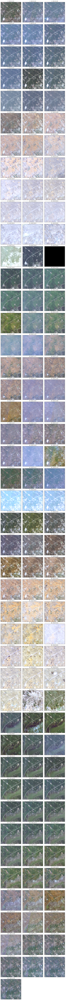

In [213]:
ncols = 3
nrows = int(math.ceil(len(chip) / ncols))
fig, axs = plt.subplots(
    nrows, ncols, figsize=(ncols * 3, nrows * 3), constrained_layout=True)
for i, (chip_t, t, t_str, ax) in enumerate(zip(chip, valid_ts, t_strs[valid_ts], axs.flat)):
    ax.imshow(chip_t)
    ax.set_title(f'{i}: {t_str}', fontsize=9)
    ax.tick_params(top=False, bottom=False, left=False, right=False,
                labelleft=False, labelbottom=False, labeltop=False)
if i < len(axs.flat) - 1:
    for ax in axs.flat[i + 1:]:
        ax.axis('off')
plt.show()

---

## Get model

We will use a model from a fork of https://github.com/jamesmcclain/geospatial-time-series.

In [23]:
from torch import nn
from torchvision.models import resnet18, resnet50

In [237]:
# model = resnet18(weights='DEFAULT')
model = resnet50(weights='DEFAULT')
model.fc = nn.Identity()
model = model.to(device=DEVICE)
model = model.eval()

In [238]:
tf = Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))

---

## Run inference

In [25]:
from tqdm import tqdm, trange
import numpy as np
from torchvision.transforms import Normalize

In [267]:
raster_source_ds = XarraySource(
    data_array.isel(time=valid_ts),
    crs_transformer=crs_transformer,
    raster_transformers=[stats_tf],
    channel_order=list(range(len(data_array.band))),
    bbox=crs_transformer.map_to_pixel(Box(*bbox)).normalize(),
    temporal=True
)
# raster_source_ds.shape

In [215]:
scene = Scene(id='test_scene', raster_source=raster_source_ds)
ds = SemanticSegmentationSlidingWindowGeoDataset(
    scene=scene, size=400, stride=400)
len(ds)

4

In [268]:
x, _ = ds[3]
x.shape

torch.Size([133, 3, 400, 400])

In [28]:
def get_embeddings(model, x, batch_size=32):
    embeddings = []
    with torch.inference_mode():
        _x = x.to(device=DEVICE)
        for i in trange(0, len(x), batch_size):
            _x_batch = _x[i: i + batch_size]
            _x_batch = tf(_x_batch)
            out = model(_x_batch)
            embeddings.append(out.cpu().numpy())
    embeddings = np.concatenate(embeddings)
    return embeddings

In [239]:
embeddings = get_embeddings(model, x, batch_size=32)
embeddings.shape

100%|█████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:02<00:00,  1.95it/s]


(133, 2048)

In [41]:
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

In [245]:
kmeans = KMeans(8)
kmeans_res = kmeans.fit(embeddings)

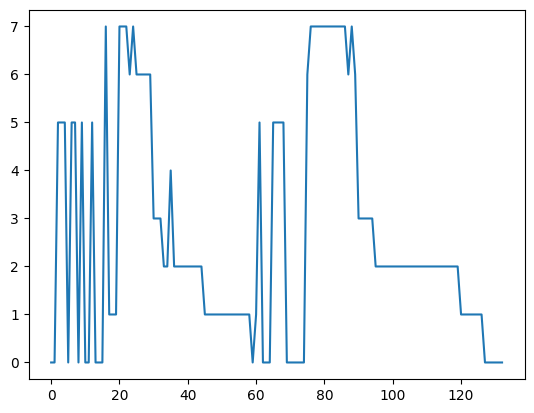

In [246]:
cs = kmeans_res.predict(embeddings)
plt.plot(cs)
plt.show()

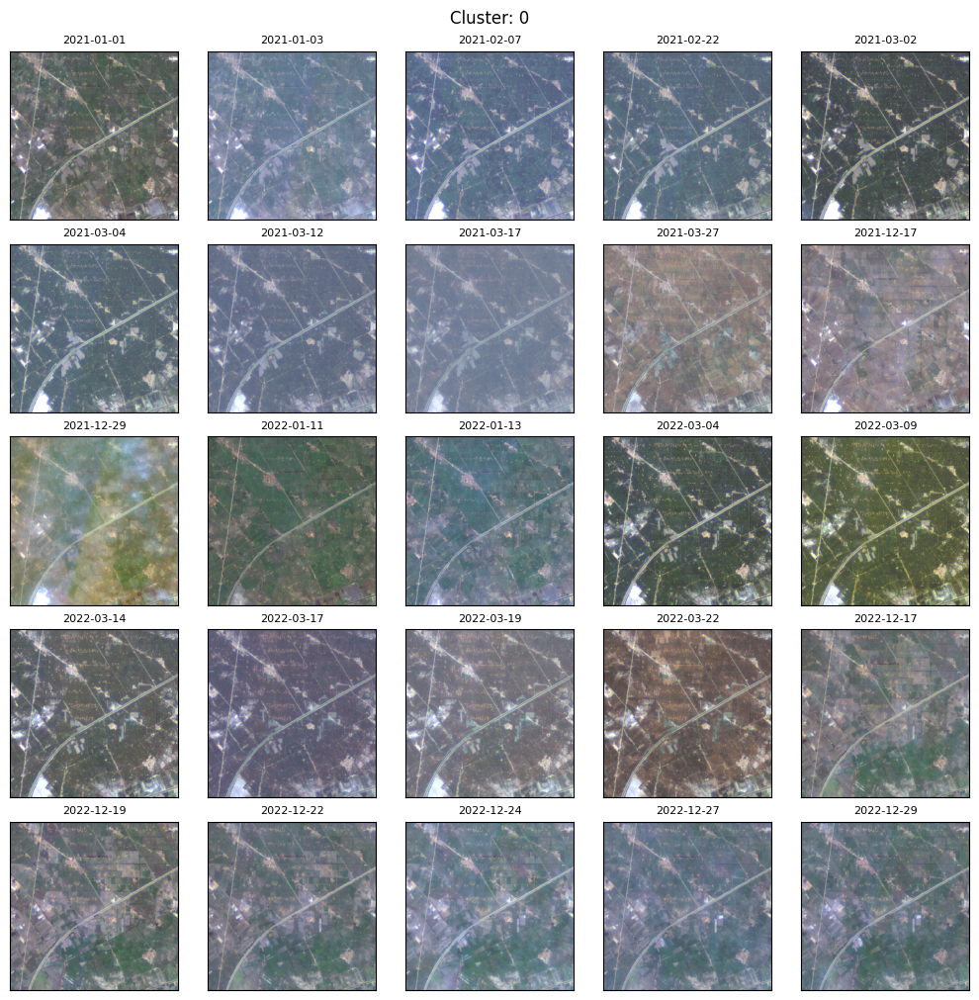

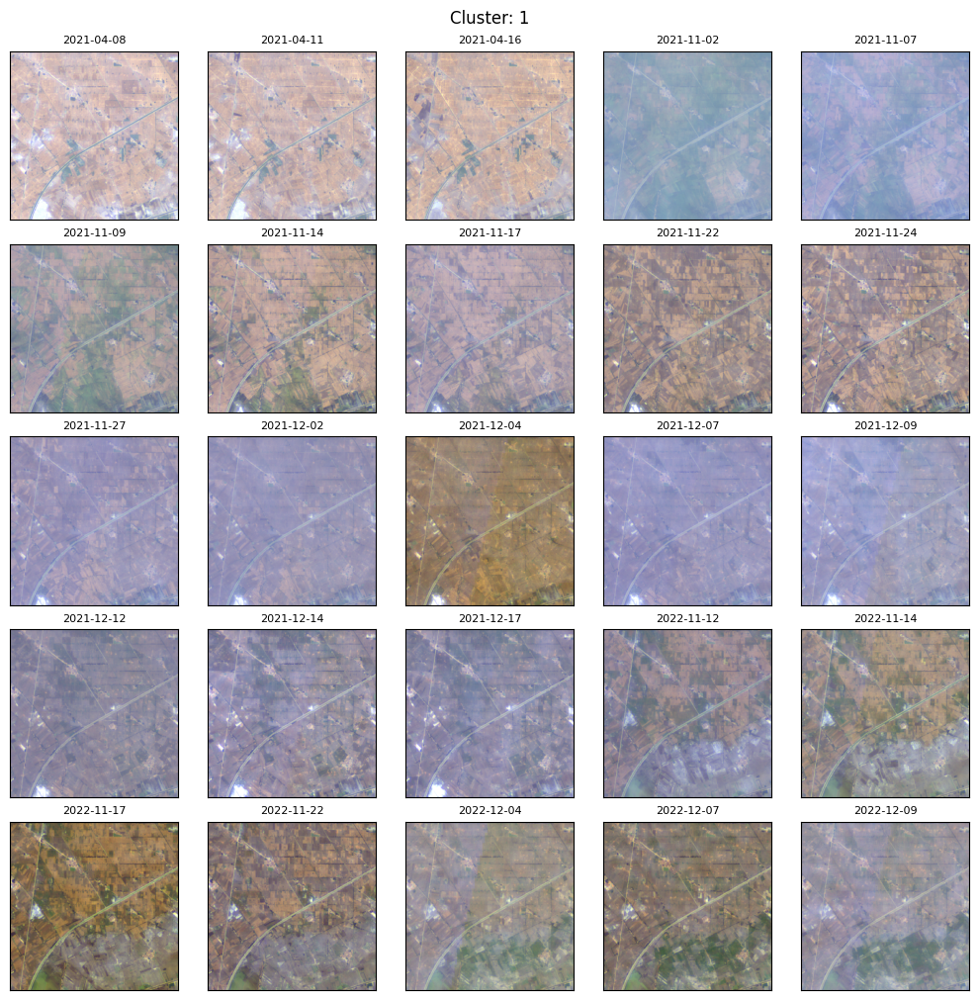

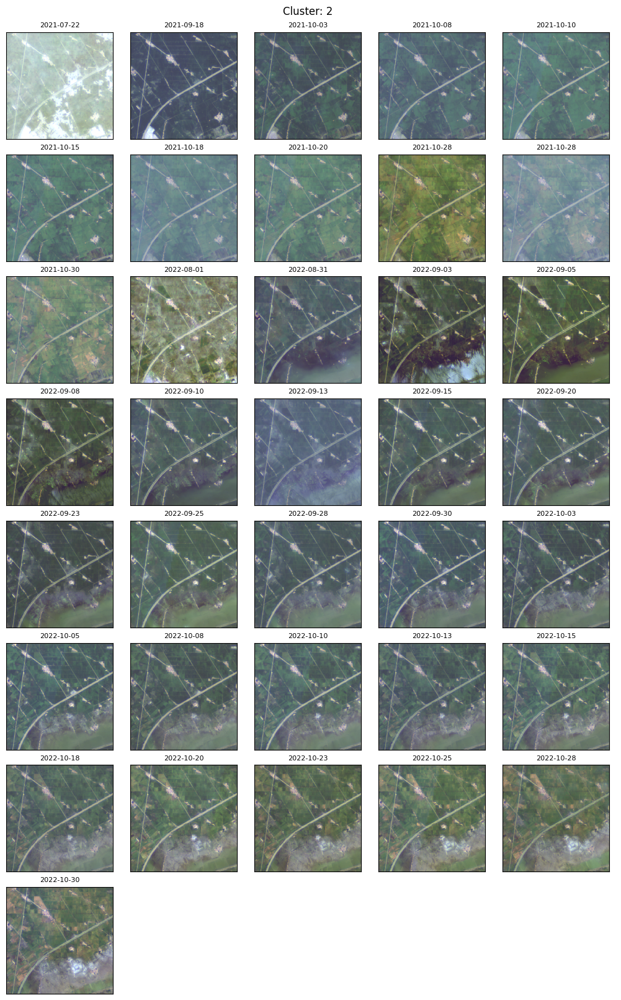

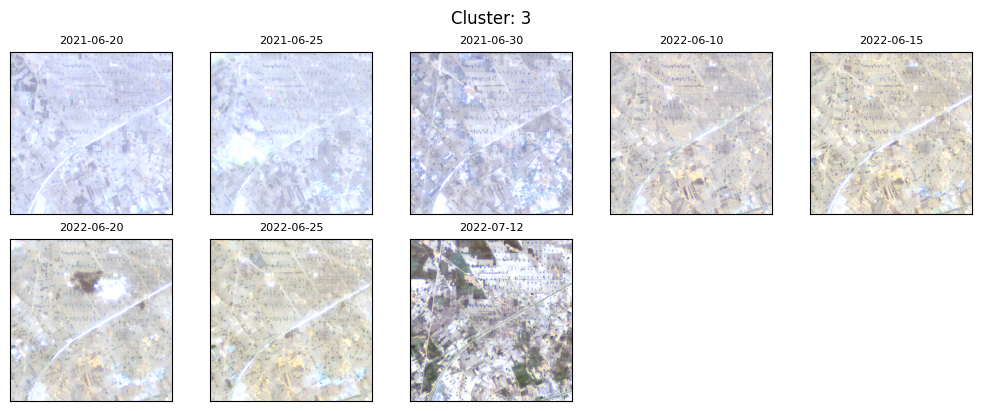

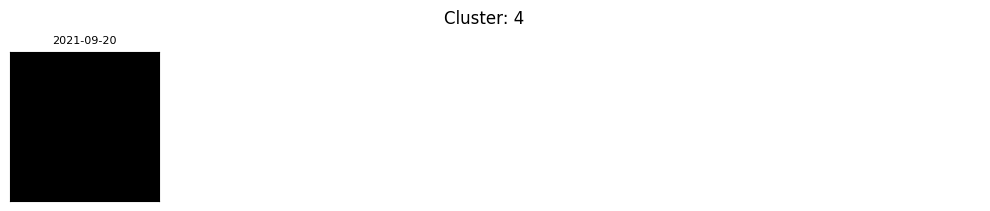

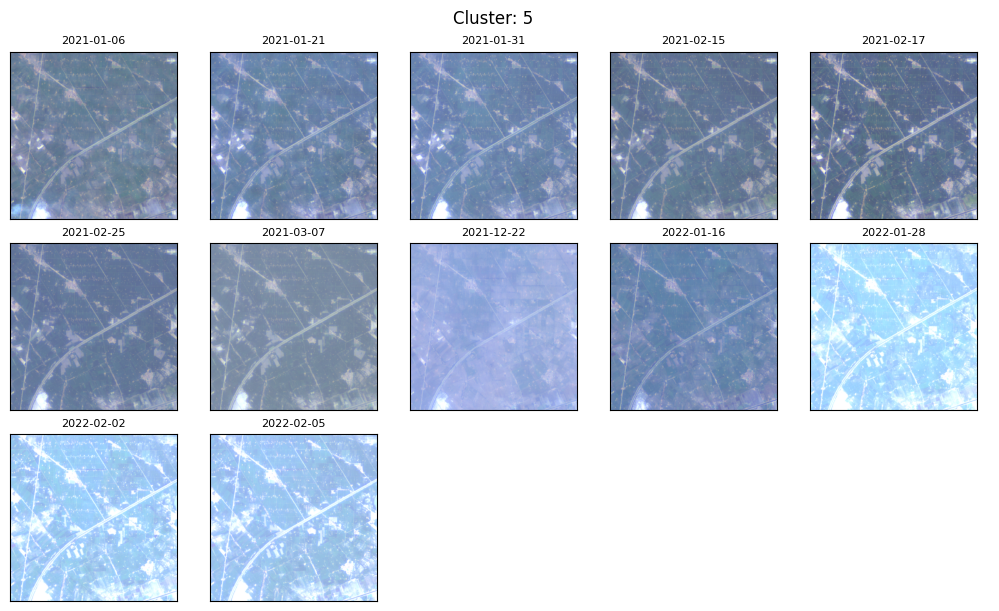

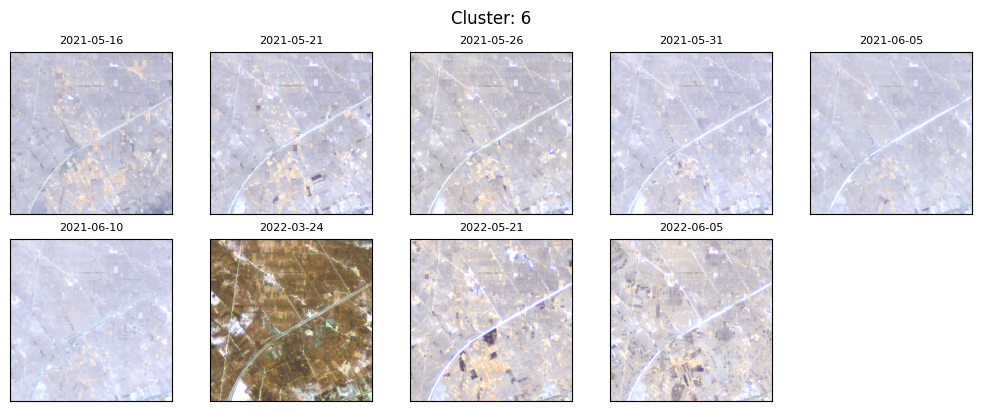

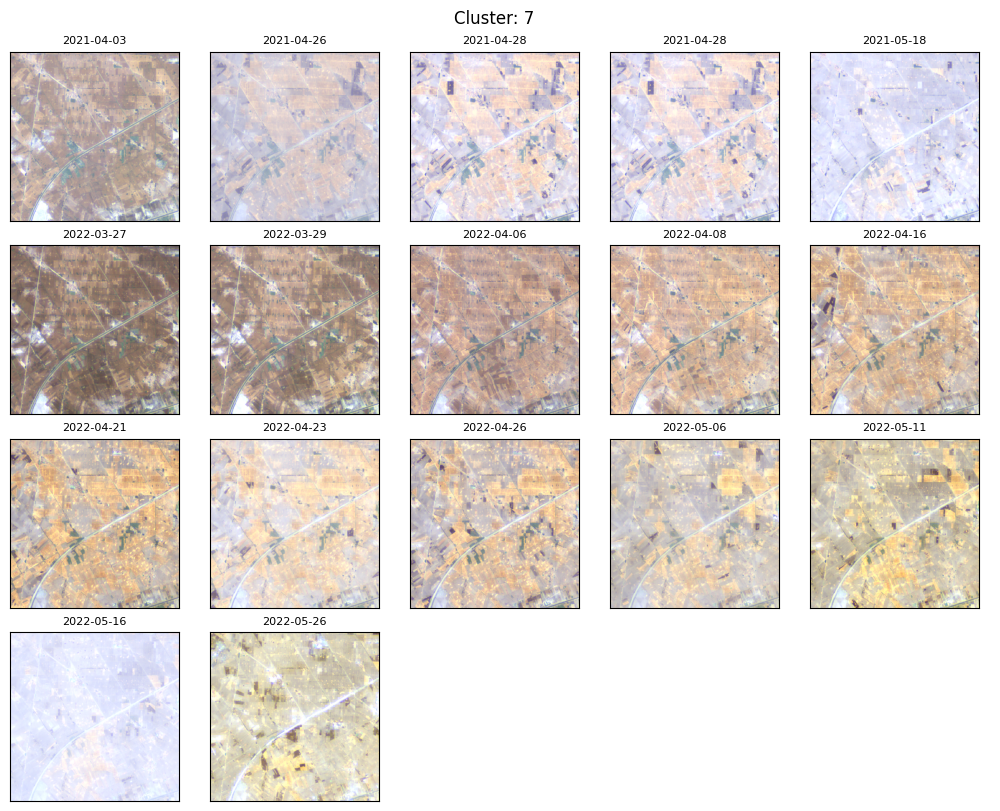

In [247]:
plt.close('all')
for c in np.unique(cs):
    mask = cs == c
    _chip = x[mask].permute(0, 2, 3, 1)
    _t_strs = t_strs[valid_ts][mask]

    ncols = 5
    nrows = int(math.ceil(len(_chip) / ncols))
    fig, axs = plt.subplots(
        nrows, ncols, figsize=(ncols * 2, nrows * 2), constrained_layout=True)
    fig.suptitle(f'Cluster: {c}')
    for i, (_chip_t, ax, _t_str_t) in enumerate(zip(_chip, axs.flat, _t_strs)):
        ax.imshow(_chip_t)
        ax.tick_params(top=False, bottom=False, left=False, right=False,
                    labelleft=False, labelbottom=False, labeltop=False)
        ax.set_title(_t_str_t, fontsize=8)
    if i < len(axs.flat) - 1:
        for ax in axs.flat[i + 1:]:
            ax.axis('off')
    plt.show()

In [270]:
np.argsort(diffs)

array([ 58,  57, 131,  14,  13,   0, 121, 130, 128,   5,  60,   6, 129,
         1, 127,   2,  95,   8,  15, 132,  53,  59,   7, 123, 120, 101,
         3,  52,  49,  56, 125, 118, 124,  55, 126,  43,  11,  64,  12,
         9, 122, 114,  47,  48, 116, 119,  18, 117,  76,  86,  72,   4,
        74,  17,  69, 115, 108, 112,  10,  42,  73,  87, 109, 111,  83,
       104, 110,  44,  40,  20,  71,  65, 106,  51, 107,  41,  27, 105,
        28,  33, 113,  34,  96,  29, 102,  19, 103,  75,  26,  70,  16,
        25,  46,  89,  78,  98,  63,  50,  80,  37,  81,  23,  45,  54,
        88,  67,  39, 100,  85,  97,  99,  68,  38,  36,  90,  62,  79,
        24,  94,  66,  61,  82,  84,  77,  21,  22,  91,  32,  92,  30,
        93,  31,  35])

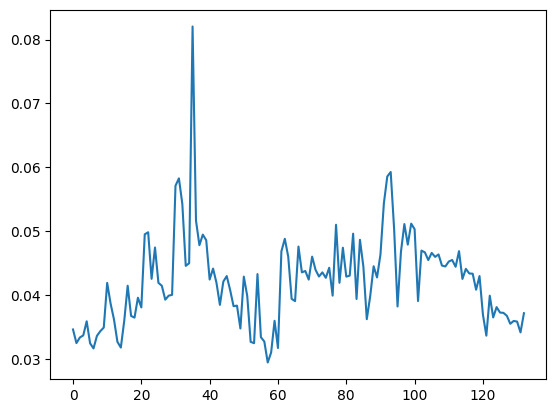

In [271]:
diffs = np.abs(embeddings - embeddings[:63].mean(axis=0)).mean(axis=-1)
plt.plot(diffs)
plt.show()

## Marinka

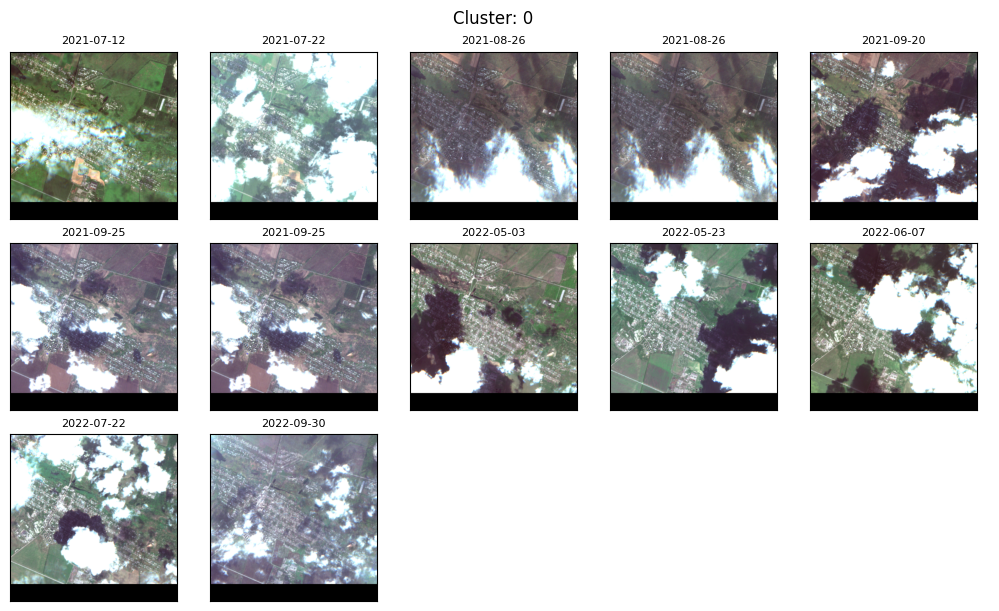

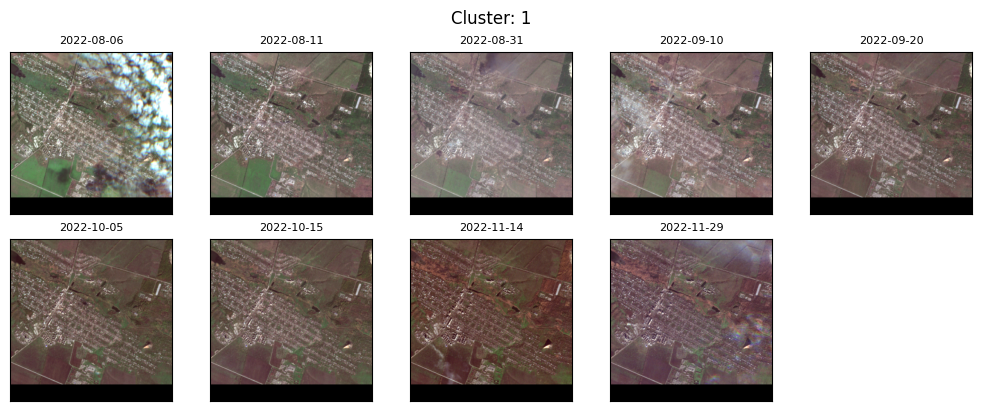

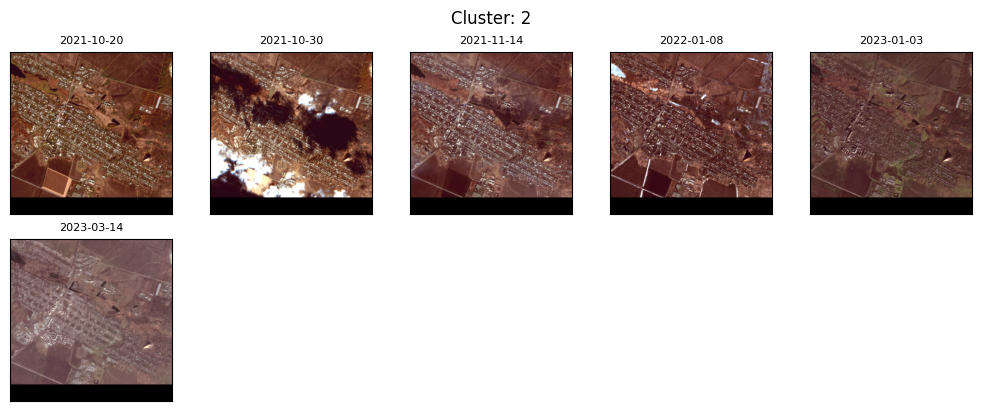

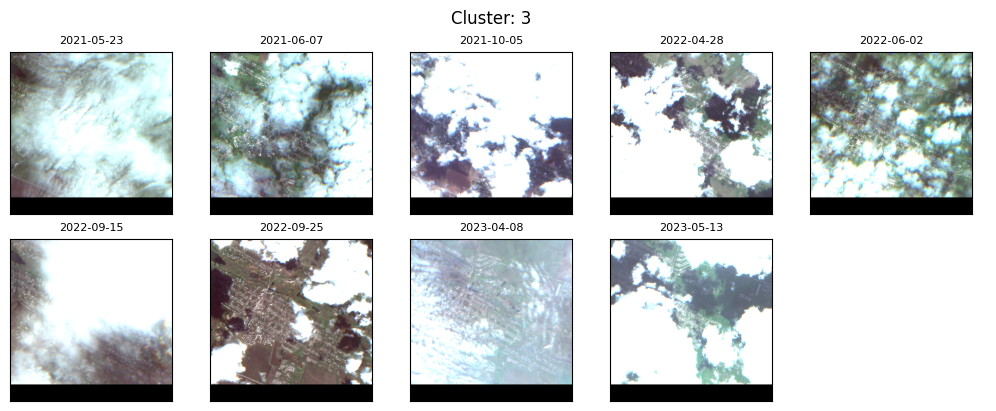

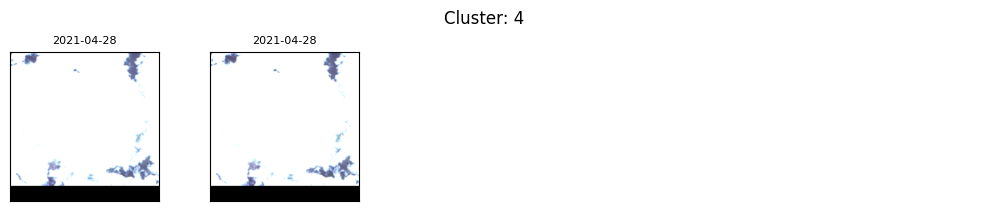

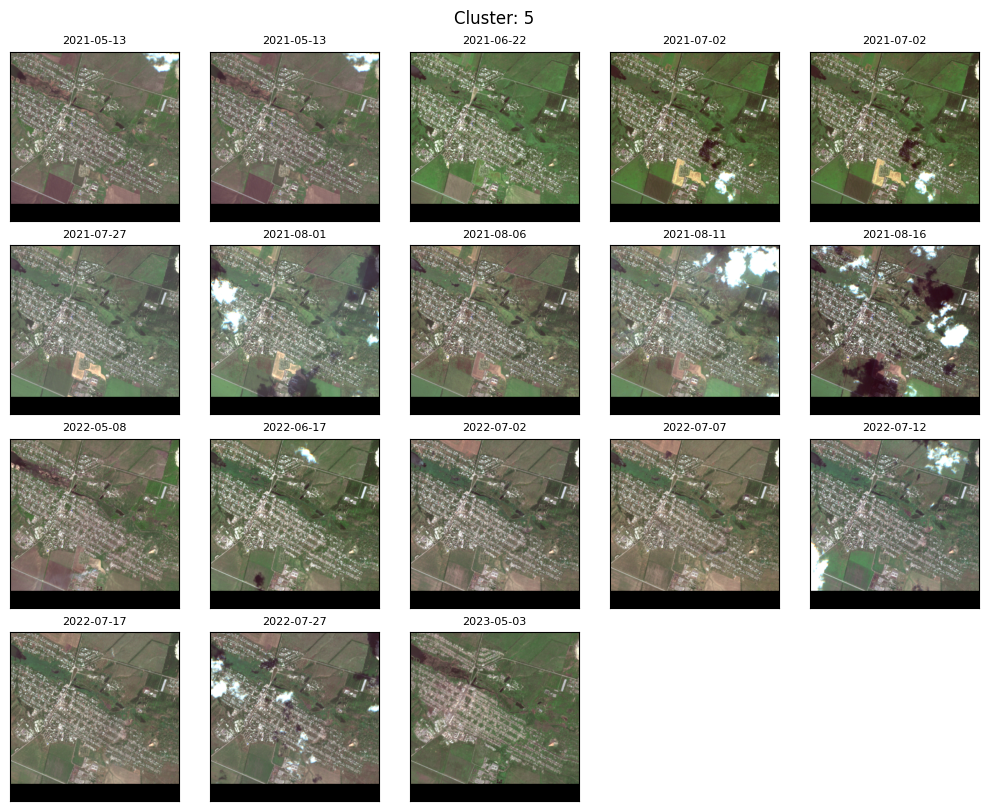

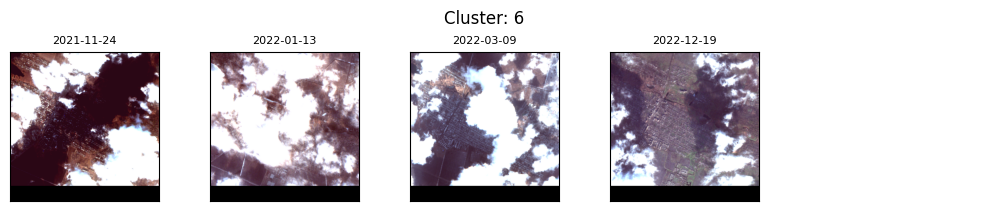

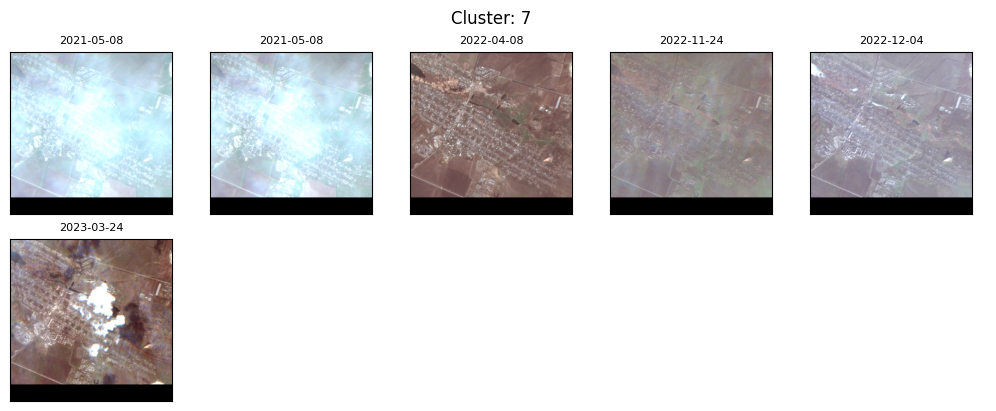

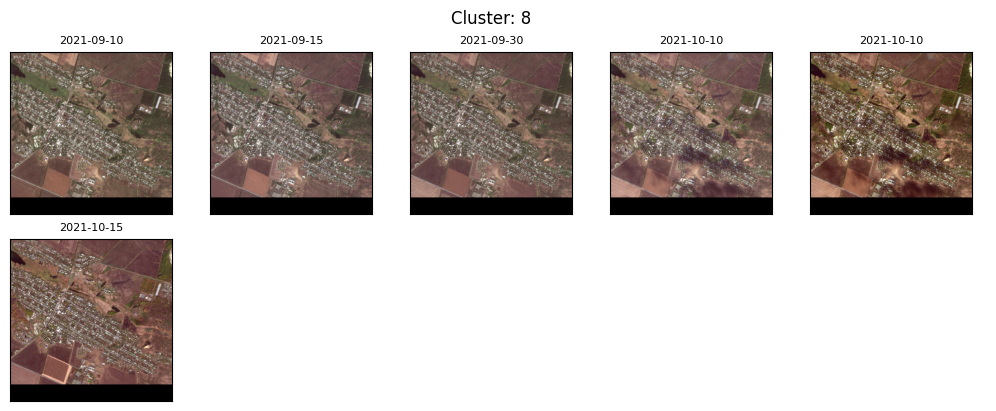

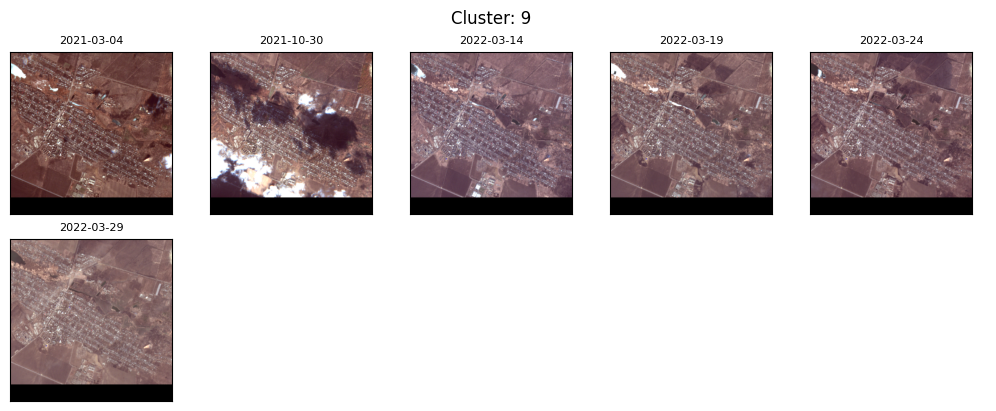

In [56]:
plt.close('all')
for c in np.unique(cs):
    mask = cs == c
    _chip = x[mask].permute(0, 2, 3, 1)
    _t_strs = t_strs[valid_ts][mask]

    ncols = 5
    nrows = int(math.ceil(len(_chip) / ncols))
    fig, axs = plt.subplots(
        nrows, ncols, figsize=(ncols * 2, nrows * 2), constrained_layout=True)
    fig.suptitle(f'Cluster: {c}')
    for i, (_chip_t, ax, _t_str_t) in enumerate(zip(_chip, axs.flat, _t_strs)):
        ax.imshow(_chip_t)
        ax.tick_params(top=False, bottom=False, left=False, right=False,
                    labelleft=False, labelbottom=False, labeltop=False)
        ax.set_title(_t_str_t, fontsize=8)
    if i < len(axs.flat) - 1:
        for ax in axs.flat[i + 1:]:
            ax.axis('off')
    plt.show()

## Mariupol

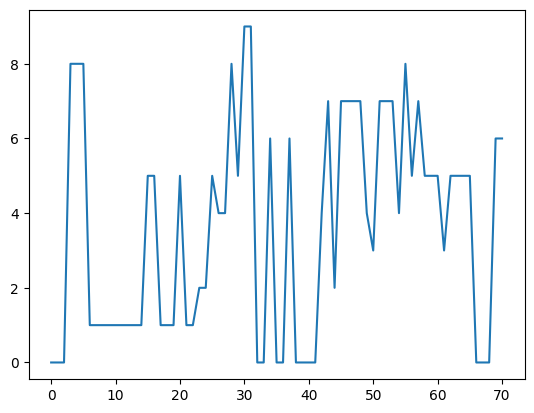

In [231]:
# plt.plot(cs[(cs != 2) & (cs != 3) & (cs != 5)])
plt.plot(cs)
plt.show()

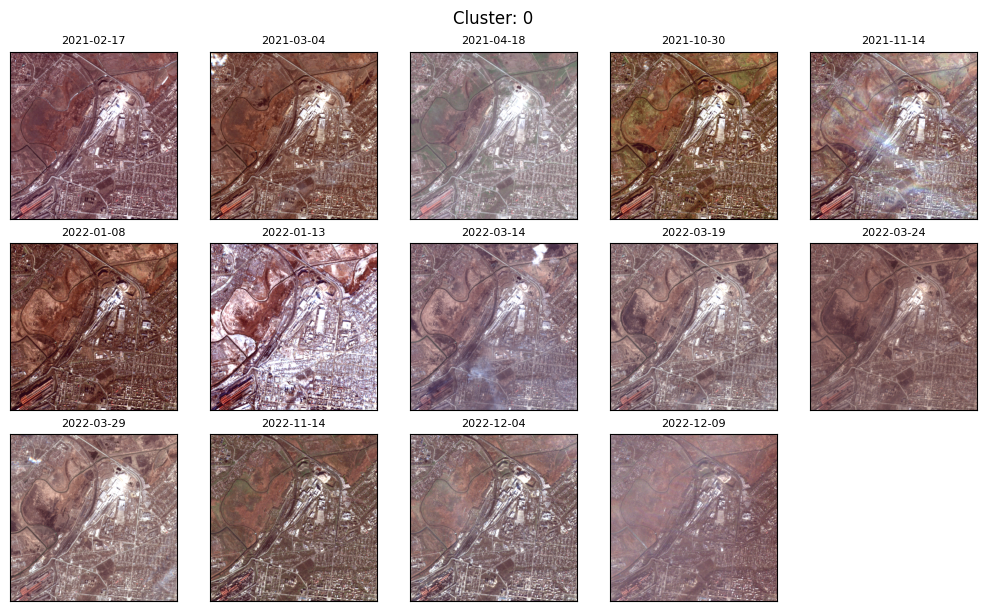

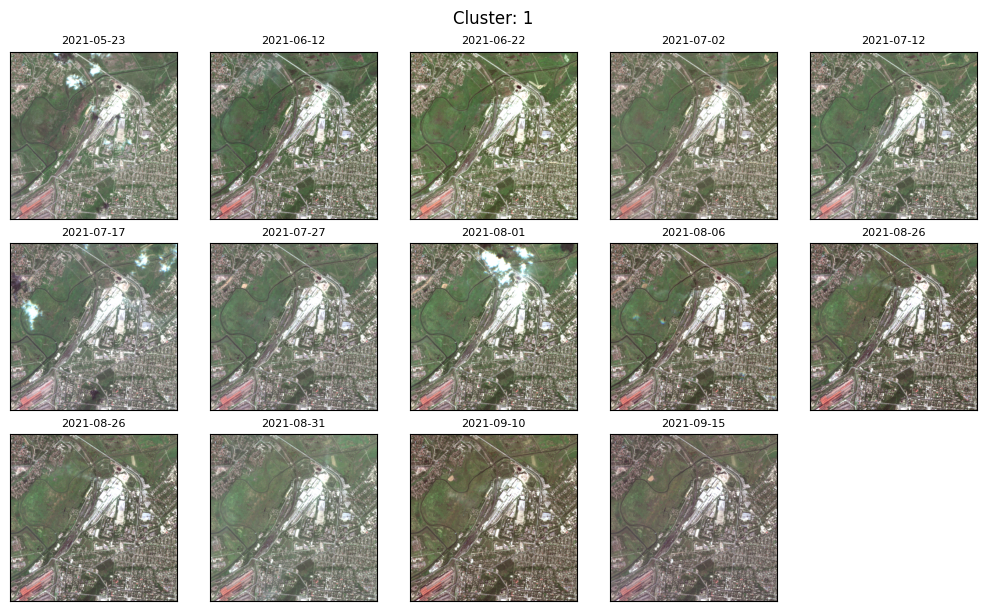

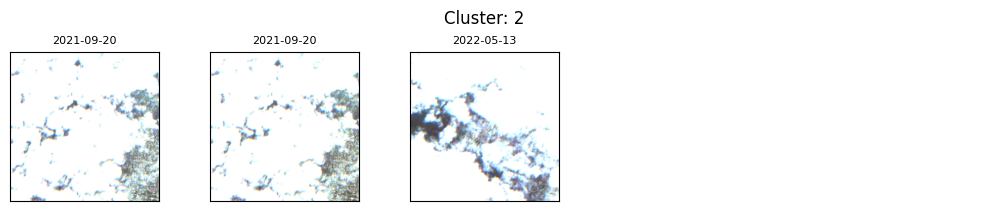

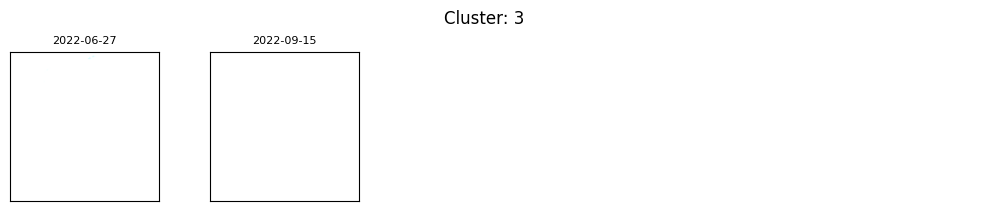

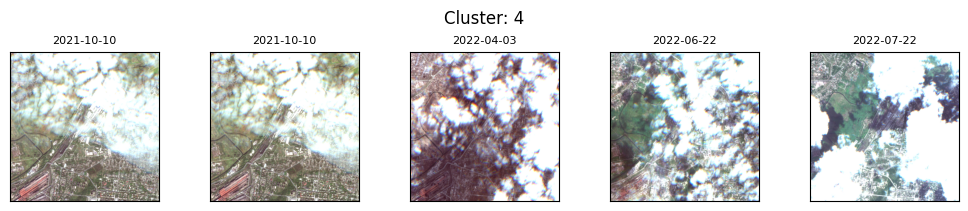

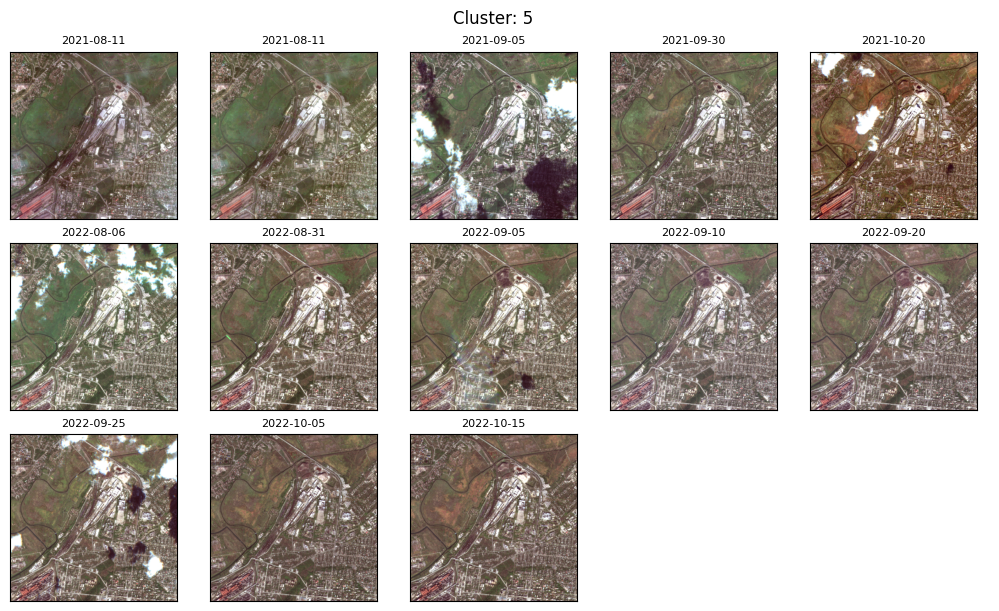

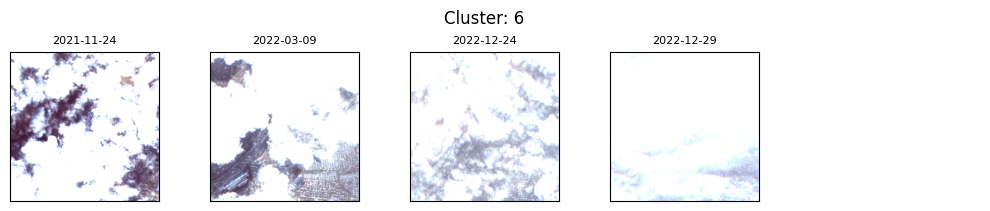

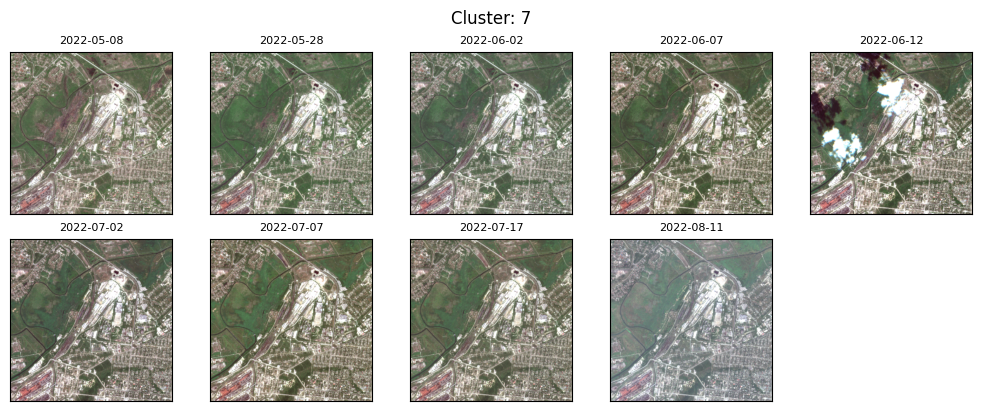

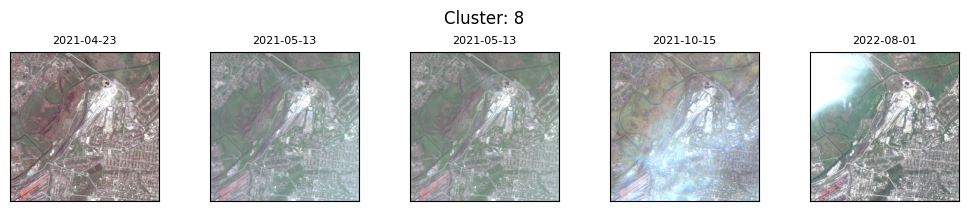

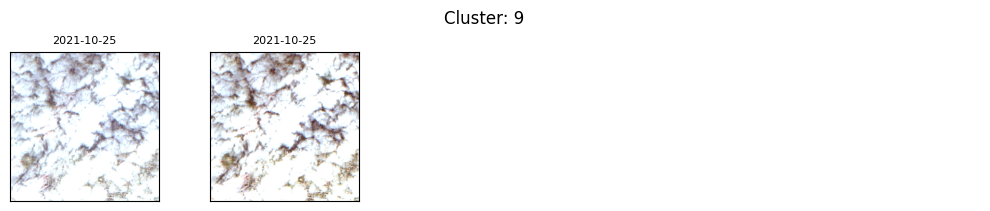

In [232]:
plt.close('all')
for c in np.unique(cs):
    mask = cs == c
    _chip = x[mask].permute(0, 2, 3, 1)
    _t_strs = t_strs[valid_ts][mask]

    ncols = 5
    nrows = int(math.ceil(len(_chip) / ncols))
    fig, axs = plt.subplots(
        nrows, ncols, figsize=(ncols * 2, nrows * 2), constrained_layout=True)
    fig.suptitle(f'Cluster: {c}')
    for i, (_chip_t, ax, _t_str_t) in enumerate(zip(_chip, axs.flat, _t_strs)):
        ax.imshow(_chip_t)
        ax.tick_params(top=False, bottom=False, left=False, right=False,
                    labelleft=False, labelbottom=False, labeltop=False)
        ax.set_title(_t_str_t, fontsize=8)
    if i < len(axs.flat) - 1:
        for ax in axs.flat[i + 1:]:
            ax.axis('off')
    plt.show()

In [151]:
x, _ = ds[10]
x.shape

torch.Size([63, 3, 256, 256])

In [154]:
embeddings = get_embeddings(model, x)
embeddings.shape

100%|█████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:00<00:00,  3.99it/s]


(63, 2048)

In [156]:
cs = kmeans_res.predict(embeddings)
cs

array([3, 1, 3, 1, 3, 2, 0, 3, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 3, 0,
       0, 1, 3, 1, 0, 2, 1, 1, 1, 3, 1, 0, 0, 0, 1, 1, 1, 2, 1, 1, 1, 2,
       3, 0, 3, 1, 1, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 3, 1, 0, 2],
      dtype=int32)

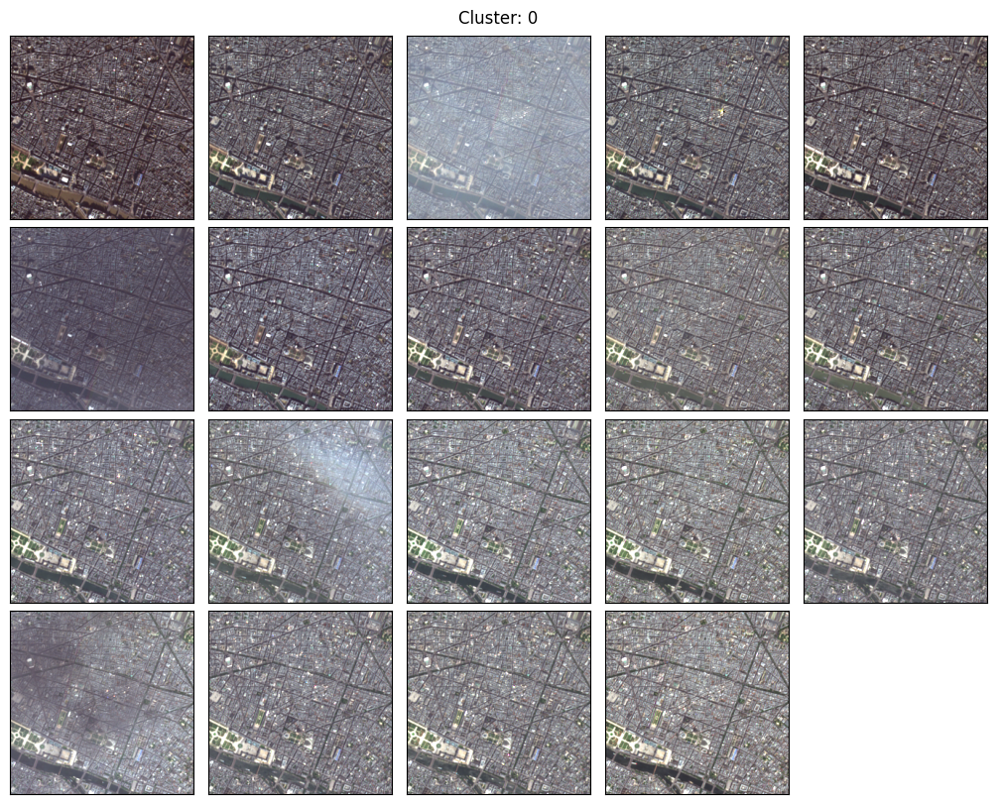

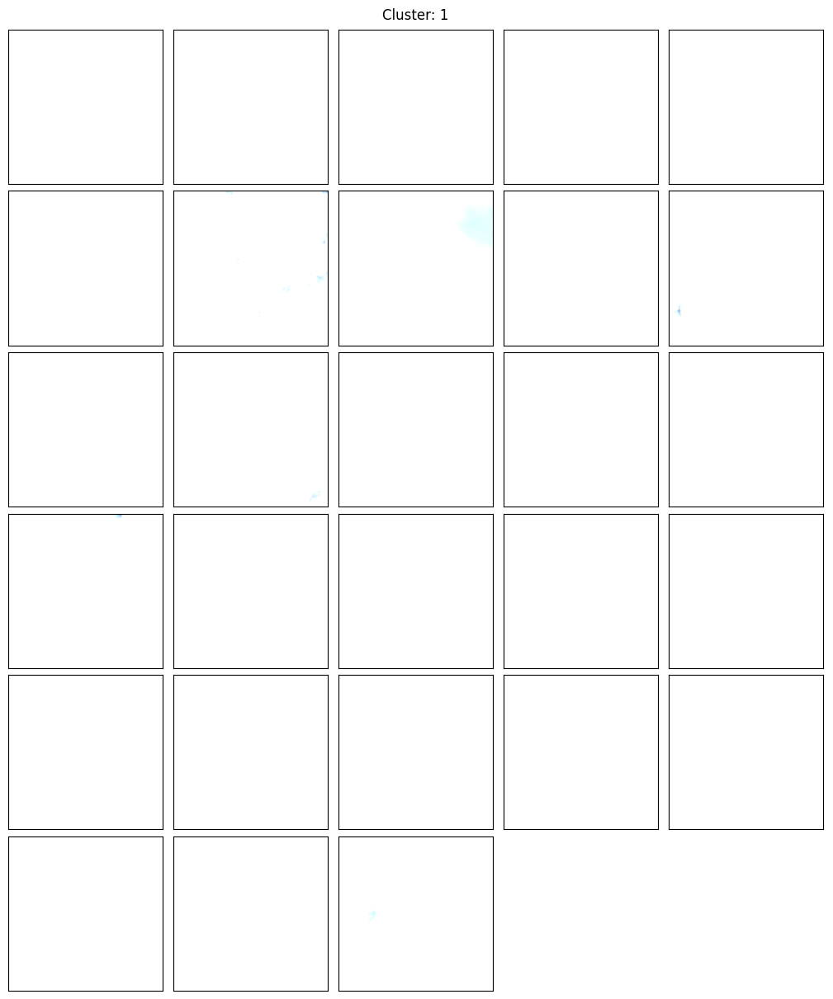

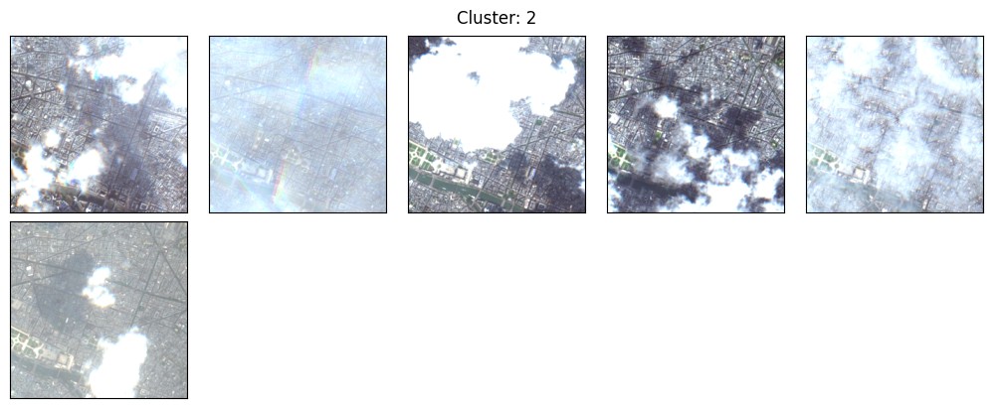

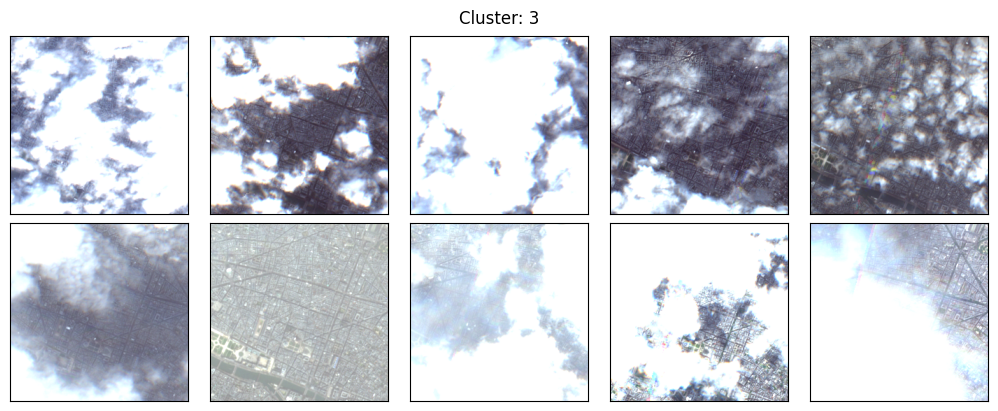

In [158]:
_chip_x = x.permute(0, 2, 3, 1)
for c in np.unique(cs):
    _chip = _chip_x[cs == c]

    ncols = 5
    nrows = int(math.ceil(len(_chip) / ncols))
    fig, axs = plt.subplots(
        nrows, ncols, figsize=(ncols * 2, nrows * 2), constrained_layout=True)
    fig.suptitle(f'Cluster: {c}')
    for i, (_chip_t, ax) in enumerate(zip(_chip, axs.flat)):
        ax.imshow(_chip_t)
        ax.tick_params(top=False, bottom=False, left=False, right=False,
                    labelleft=False, labelbottom=False, labeltop=False)
    if i < len(axs.flat) - 1:
        for ax in axs.flat[i + 1:]:
            ax.axis('off')
    plt.show()

In [64]:
tsne = TSNE()
tsne_embeddings = tsne.fit_transform(embeddings)
tsne_embeddings.shape

(63, 2)